#### 1.1. Conditional Generative Models
$$p(x, z|\theta, c) = p(x|\theta, c, z)p(z|\theta, c)$$


$$\mathcal{L}_{\text{ELBO}} = \mathbb{E}_{z \sim q_\phi(z|x)}[\log p_\theta(x|z)] - D_{KL}(q_\phi(z|x) || p_\theta(z))$$

#### 1.2. Conditional Diffusion Models
$$x_t = \sqrt{\bar{\alpha}_t}x_0 + \sqrt{1 - \bar{\alpha}_t}\epsilon$$

$$\mathcal{L}_{\text{ELBO}} = \sum_{t=1}^{T} ||\epsilon(x_t, t, c|\theta) - \epsilon||^2$$

#### 1.3. Continual Learning
$$\log p(\theta|D_A, D_B) = \log p(D_B|\theta) - \frac{\lambda}{2} \sum_i F_i(\theta_i - \theta_i^*)^2$$


$$F_i = \mathbb{E}_{p(x|\theta^*,c)p(c)}\left[\left(\frac{\partial}{\partial\theta_i} \mathcal{L}_{\text{ELBO}}(x, c; \theta)\right)^2\right]$$

---
### Part 2: The Selective Amnesia Method (Derivation and Final Formula)



$$\log p(\theta|D_r) = - \log p(x_f|\theta, c_f) - \lambda \sum_i \frac{F_i}{2}(\theta_i - \theta_i^*)^2 + C$$



$$\log p(\theta|D_r) = \frac{1}{2} \left[ - \log p(x_f|\theta, c_f) - \lambda \sum_i \frac{F_i}{2}(\theta_i - \theta_i^*)^2 + \log p(x_r|\theta, c_r) + \log p(\theta) \right] + C$$




$$E_{p(x|c)p_f(c)}[\log p(x|\theta^q, c)] \le E_{p(x|c)p_f(c)}[\log p(x|\theta^*, c)]$$



$$E_{p(x|c)p_f(c)}[\log p(x|\theta^q, c) - \log p(x|\theta^*, c)] = -E_{p_f(c)}[D_{KL}(p(x|c) || q(x|c))]$$

#### 2.2. The Final Objective Function (Eq. 4)

$$L_{\text{SA}} = \underbrace{\mathbb{E}_{q(x|c)p_f(c)}[\mathcal{L}_{\text{ELBO}}(x|\theta, c)]}_{\text{Forget Term}} + \underbrace{\mathbb{E}_{p(x|c)p_r(c)}[\mathcal{L}_{\text{ELBO}}(x|\theta, c)]}_{\text{Remember Term}} - \underbrace{\lambda \sum_i \frac{F_i}{2}(\theta_i - \theta_i^*)^2}_{\text{Stability Term}}$$


$$H(P_\phi(y|x_f)) = -E_{p(x|\theta, c_f)} \left[ \sum_i P_\phi(y=c_i|x_f) \log P_\phi(y=c_i|x_f) \right]$$

In [ ]:
from __future__ import annotations
import argparse, random, pathlib, math
from typing import Tuple

import numpy as np
import torch, torch.nn as nn, torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from tqdm.auto import tqdm


In [ ]:
    ap = argparse.ArgumentParser()
    ap.add_argument("--epochs", type=int, default=500)
    ap.add_argument("--sa_epochs", type=int, default=5)
    ap.add_argument("--batch", type=int, default=512)
    ap.add_argument("--lr", type=float, default=5e-4)
    ap.add_argument("--lam", type=float, default=100)
    ap.add_argument("--seed", type=int, default=48)
    ap.add_argument("--quick", action="store_true", help="use fast demo settings")


_StoreTrueAction(option_strings=['--quick'], dest='quick', nargs=0, const=True, default=False, type=None, choices=None, required=False, help='use fast demo settings', metavar=None)

In [ ]:

def set_seed(seed: int = 42):
    random.seed(seed); np.random.seed(seed)
    torch.manual_seed(seed); torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False




In [ ]:
def show_grid(imgs: torch.Tensor, title: str):
    """Utility for 28×28 greyscale grids."""
    imgs = imgs.cpu().view(-1, 28, 28)
    n, cols = imgs.size(0), 10
    rows = math.ceil(n / cols)
    grid = torch.ones(rows * 28, cols * 28)
    for i, im in enumerate(imgs):
        r, c = divmod(i, cols)
        grid[r*28:(r+1)*28, c*28:(c+1)*28] = im
    plt.figure(figsize=(cols*1.1, rows*1.1))
    plt.title(title); plt.imshow(grid, cmap="gray"); plt.axis("off"); plt.show()


In [ ]:
class ConditionalVAE(nn.Module):
    def __init__(self, z_dim=16, hidden=512, n_classes=10):
        super().__init__(); self.z_dim = z_dim
        in_dim = 28*28 + n_classes
        self.encoder = nn.Sequential(
            nn.Linear(in_dim, hidden), nn.ReLU(),
            nn.Linear(hidden, hidden), nn.ReLU())
        self.mu, self.logvar = nn.Linear(hidden, z_dim), nn.Linear(hidden, z_dim)
        self.decoder = nn.Sequential(
            nn.Linear(z_dim + n_classes, hidden), nn.ReLU(),
            nn.Linear(hidden, hidden), nn.ReLU(),
            nn.Linear(hidden, 28*28), nn.Sigmoid())

    def forward(self, x, y):
        h = self.encoder(torch.cat([x, y], 1))
        mu, lv = self.mu(h), self.logvar(h)
        z = mu + torch.exp(0.5*lv) * torch.randn_like(mu)
        recon = self.decoder(torch.cat([z, y], 1))
        return recon, mu, lv

    @torch.no_grad()
    def sample(self, n, y, device="cpu"):
        z = torch.randn(n, self.z_dim, device=device)
        return self.decoder(torch.cat([z, y], 1)).view(-1, 1, 28, 28)


In [ ]:

def elbo(recon, x, mu, lv):
    bce = F.binary_cross_entropy(recon, x, reduction="sum")
    kld = -0.5*torch.sum(1 + lv - mu.pow(2) - lv.exp())
    return (bce + kld) / x.size(0)





$$\mathcal{L}_{\text{ELBO}} = \underbrace{-\mathbb{E}_{z \sim q_\phi(z|x)}[\log p_\theta(x|z)]}_{\text{Reconstruction Loss}} + \underbrace{D_{KL}(q_\phi(z|x) || p_\theta(z))}_{\text{KL Divergence}}$$


In [ ]:
def loaders(bs=256):
    tf = transforms.ToTensor()
    tr = datasets.MNIST("./data", True, download=True, transform=tf)
    te = datasets.MNIST("./data", False, download=True, transform=tf)
    def onehot(y):
        oh = torch.zeros(len(y), 10); oh[torch.arange(len(y)), y] = 1; return oh
    def wrap(ds):
        xs, ys = zip(*ds); return TensorDataset(torch.stack(xs), onehot(torch.tensor(ys)))
    return DataLoader(wrap(tr), bs, True, drop_last=True), DataLoader(wrap(te), bs)



In [ ]:
def diag_fisher(model, dl, device, batches=400):
    model.eval(); fim = [torch.zeros_like(p) for p in model.parameters() if p.requires_grad]
    it = iter(dl)
    for _ in tqdm(range(batches), desc="Fisher"):
        try: x,y = next(it)
        except StopIteration: it = iter(dl); x,y = next(it)
        x,y = x.to(device), y.to(device); x = x.view(x.size(0), -1)
        recon, mu, lv = model(x,y); loss = elbo(recon,x,mu,lv)
        model.zero_grad(); loss.backward()
        for f,p in zip(fim, model.parameters()):
            if p.grad is not None: f += p.grad.pow(2)
    return [f / batches for f in fim]



$$F_i = \mathbb{E}_{p_{\text{data}}(x, y)} \left[ \left( \frac{\partial}{\partial \theta_i} \mathcal{L}_{\text{ELBO}}(x, y; \theta) \right)^2 \right]$$



In [ ]:
@torch.no_grad()
def replay_dataset(model, device, per_cls=1500, forget=2):
    xs, ys = [], []
    for c in range(10):
        if c == forget: continue
        y = torch.zeros(per_cls,10,device=device); y[:,c] = 1
        xs.append(model.sample(per_cls, y, device).cpu()); ys.append(y.cpu())
    return TensorDataset(torch.vstack(xs), torch.vstack(ys))

def surrogate_dataset(n=60000, cls=2):
    xs = torch.rand(n,1,28,28); ys = torch.zeros(n,10); ys[:,cls]=1
    return TensorDataset(xs, ys)


In [ ]:
def selective_amnesia(model, theta_star, fisher, rep_dl, sur_dl, device, lam=100, epochs=10, lr=5e-4):
    opt = torch.optim.Adam(model.parameters(), lr=lr)
    params = [p for p in model.parameters() if p.requires_grad]
    for ep in range(epochs):
        for (xr,yr),(xf,yf) in zip(rep_dl, sur_dl):
            xr,yr,xf,yf = xr.to(device),yr.to(device),xf.to(device),yf.to(device)
            xr = xr.view(xr.size(0),-1); xf = xf.view(xf.size(0),-1)
            rec_r,mu_r,lv_r = model(xr,yr)
            rec_f,mu_f,lv_f = model(xf,yf)
            loss = elbo(rec_r,xr,mu_r,lv_r) + elbo(rec_f,xf,mu_f,lv_f)
            ewc = sum(torch.sum(f*(p-p0).pow(2)) for p,p0,f in zip(params,theta_star,fisher))
            loss = loss + lam*ewc/len(rep_dl.dataset)
            opt.zero_grad(); loss.backward(); opt.step()
        print(f"[SA] {ep+1}/{epochs}  loss:{loss.item():.4f}")





$$\mathcal{L}_{\text{total}} = \underbrace{\mathcal{L}_{\text{ELBO}}(x_r, y_r; \theta)}_{\text{Replay Loss}} + \underbrace{\mathcal{L}_{\text{ELBO}}(x_f, y_f; \theta)}_{\text{Surrogate Loss}} + \underbrace{\frac{\lambda}{N_r} \sum_i F_i (\theta_i - \theta_i^*)^2}_{\text{EWC Penalty}}$$



In [ ]:
def train_vae(model, dl, opt, device):
    model.train(); tot=0
    for x,y in tqdm(dl,leave=False):
        x,y = x.to(device), y.to(device); x = x.view(x.size(0),-1)
        rec,mu,lv = model(x,y); loss = elbo(rec,x,mu,lv)
        opt.zero_grad(); loss.backward(); opt.step(); tot += loss.item()*x.size(0)
    return tot/len(dl.dataset)



Baseline training for 500 epochs …


  0%|          | 0/117 [00:00<?, ?it/s]

  ep 1: ELBO=229.9947


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 10: ELBO=110.6304


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 20: ELBO=101.8807


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 30: ELBO=98.3949


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 40: ELBO=96.3046


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 50: ELBO=94.8670


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 60: ELBO=93.8221


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 70: ELBO=93.0348


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 80: ELBO=92.3924


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 90: ELBO=91.8293


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 100: ELBO=91.3970


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 110: ELBO=90.9910


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 120: ELBO=90.6724


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 130: ELBO=90.3659


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 140: ELBO=90.1065


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 150: ELBO=89.8436


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 160: ELBO=89.6253


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 170: ELBO=89.4035


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 180: ELBO=89.2369


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 190: ELBO=89.0912


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 200: ELBO=88.8948


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 210: ELBO=88.8494


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 220: ELBO=88.6594


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 230: ELBO=88.5381


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 240: ELBO=88.4414


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 250: ELBO=88.3266


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 260: ELBO=88.1847


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 270: ELBO=88.1157


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 280: ELBO=88.0010


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 290: ELBO=87.9159


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 300: ELBO=87.8786


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 310: ELBO=87.7970


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 320: ELBO=87.7612


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 330: ELBO=87.6592


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 340: ELBO=87.5774


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 350: ELBO=87.5102


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 360: ELBO=87.4122


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 370: ELBO=87.3657


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 380: ELBO=87.3267


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 390: ELBO=87.2335


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 400: ELBO=87.2012


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 410: ELBO=87.1330


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 420: ELBO=87.1067


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 430: ELBO=87.0822


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 440: ELBO=86.9833


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 450: ELBO=86.9578


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 460: ELBO=86.9058


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 470: ELBO=86.8507


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 480: ELBO=86.8516


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 490: ELBO=86.7740


  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  0%|          | 0/117 [00:00<?, ?it/s]

  ep 500: ELBO=86.7296


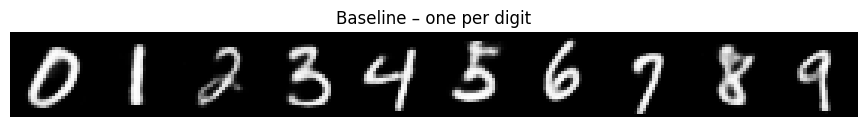

Fisher:   0%|          | 0/400 [00:00<?, ?it/s]

Selective Amnesia phase …
[SA] 1/5  loss:799.7701
[SA] 2/5  loss:677.8718
[SA] 3/5  loss:668.3115
[SA] 4/5  loss:666.8052
[SA] 5/5  loss:662.7645


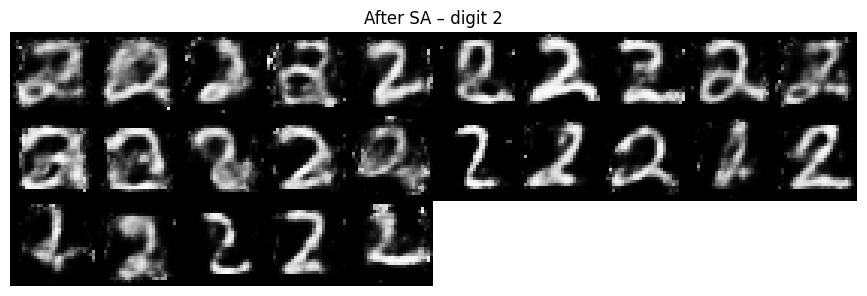

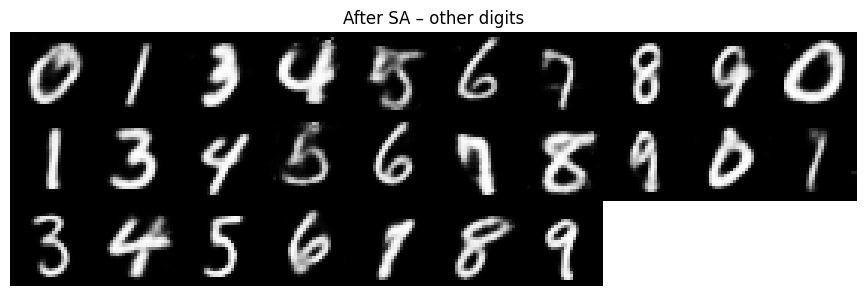

In [ ]:
args, _ = ap.parse_known_args()

cfg = args
set_seed(cfg.seed)

dev = torch.device("cuda" if torch.cuda.is_available() else "cpu")
tr_dl, _ = loaders(cfg.batch)
vae = ConditionalVAE().to(dev)

if cfg.quick:
    cfg.epochs, cfg.sa_epochs, cfg.lr = 10, 3, 1e-3

print(f"Baseline training for {cfg.epochs} epochs …")
optim = torch.optim.Adam(vae.parameters(), lr=cfg.lr)
for ep in range(cfg.epochs):
    el = train_vae(vae, tr_dl, optim, dev)
    if (ep+1)%10==0 or ep==0: print(f"  ep {ep+1}: ELBO={el:.4f}")

show_grid(vae.sample(10, torch.eye(10,device=dev), dev), "Baseline – one per digit")

theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
rep_dl = DataLoader(replay_dataset(vae, dev), cfg.batch, True, drop_last=True)
fisher = diag_fisher(vae, rep_dl, dev)
sur_dl = DataLoader(surrogate_dataset(), cfg.batch, True, drop_last=True)

print("Selective Amnesia phase …")
selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=cfg.sa_epochs, lr=cfg.lr)

show_grid(vae.sample(25, torch.eye(10)[[2]].repeat(25,1).to(dev), dev), "After SA – digit 2")
others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]].repeat(3,1).to(dev)
show_grid(vae.sample(27, others, dev), "After SA – other digits")



Selective Amnesia phase …
[SA] 1/20  loss:656.0593
[SA] 2/20  loss:653.0077
[SA] 3/20  loss:648.7285
[SA] 4/20  loss:646.8781
[SA] 5/20  loss:644.1664
[SA] 6/20  loss:643.8563
[SA] 7/20  loss:643.5774
[SA] 8/20  loss:643.1440
[SA] 9/20  loss:641.6169
[SA] 10/20  loss:642.8735
[SA] 11/20  loss:639.9496
[SA] 12/20  loss:640.8336
[SA] 13/20  loss:640.9505
[SA] 14/20  loss:640.3836
[SA] 15/20  loss:642.1732
[SA] 16/20  loss:638.7228
[SA] 17/20  loss:640.0219
[SA] 18/20  loss:639.1849
[SA] 19/20  loss:640.1590
[SA] 20/20  loss:641.9908


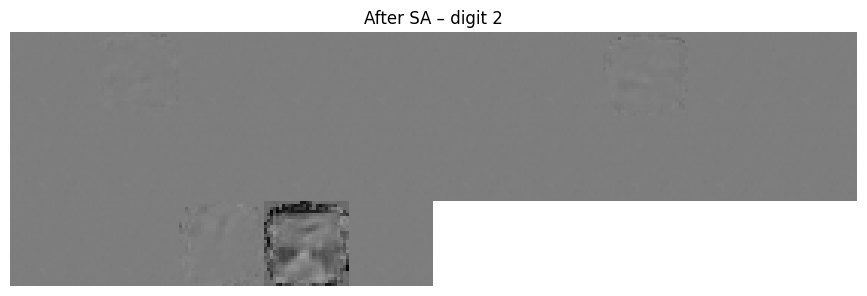

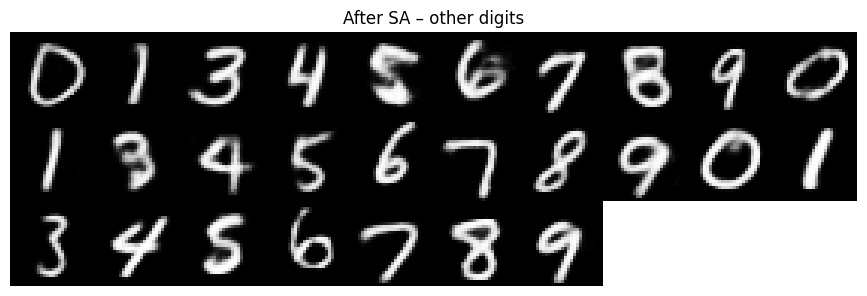

In [ ]:

    print("Selective Amnesia phase …")
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=20, lr=cfg.lr)

    show_grid(vae.sample(25, torch.eye(10)[[2]].repeat(25,1).to(dev), dev), "After SA – digit 2")
    others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]].repeat(3,1).to(dev)
    show_grid(vae.sample(27, others, dev), "After SA – other digits")



In [ ]:
from __future__ import annotations
import argparse
import random
import pathlib
import math
from typing import Tuple

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from tqdm.auto import tqdm



def get_args():
    ap = argparse.ArgumentParser()
    ap.add_argument("--epochs", type=int, default=500, help="Epochs for initial training.")
    ap.add_argument("--sa_epochs", type=int, default=10, help="Epochs for selective amnesia.")
    ap.add_argument("--batch", type=int, default=256)
    ap.add_argument("--lr", type=float, default=5e-4)
    ap.add_argument("--lam", type=float, default=100, help="EWC regularization parameter.")
    ap.add_argument("--seed", type=int, default=49)
    ap.add_argument("--quick", action="store_true", help="Use fast demo settings (fewer epochs).")
    
    args, _ = ap.parse_known_args()
    return args



def set_seed(seed: int = 42):
    """Sets random seeds for reproducibility."""
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

def show_grid(imgs: torch.Tensor, title: str):
    """Utility for displaying 28x28 grayscale image grids."""
    imgs = imgs.cpu().view(-1, 28, 28)
    n, cols = imgs.size(0), 10
    rows = math.ceil(n / cols)
    grid = torch.ones(rows * 28, cols * 28)
    for i, im in enumerate(imgs):
        r, c = divmod(i, cols)
        grid[r*28:(r+1)*28, c*28:(c+1)*28] = im
    plt.figure(figsize=(cols * 1.1, rows * 1.1))
    plt.title(title, fontsize=16)
    plt.imshow(grid, cmap="gray")
    plt.axis("off")
    plt.show()

def plot_latent_space(model, dl, device, title):
    """Encodes data and plots its 2D latent space representation."""
    model.eval()
    latents, labels = [], []
    with torch.no_grad():
        for x, y in dl:
            x, y = x.to(device), y.to(device)
            x_flat = x.view(x.size(0), -1)
            
            _, mu, _ = model(x_flat, y)
            latents.append(mu.cpu())
            labels.append(y.cpu().argmax(dim=1))

    latents = torch.cat(latents).numpy()
    labels = torch.cat(labels).numpy()

    plt.figure(figsize=(30, 25))
    
    cmap = plt.get_cmap('tab10', 10)
    scatter = plt.scatter(latents[:, 0], latents[:, 1], c=labels, cmap=cmap, s=10, alpha=0.7)
    plt.title(title, fontsize=16)
    plt.xlabel("Latent Dimension 1")
    plt.ylabel("Latent Dimension 2")
    plt.legend(handles=scatter.legend_elements()[0], labels=list(range(10)), title="Digits")
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()



from sklearn.decomposition import PCA
import torchvision.utils as vutils

class ConvolutionalConditionalVAE(nn.Module):
    def __init__(self, z_dim=8, n_classes=10):
        super().__init__()
        self.z_dim = z_dim
        self.n_classes = n_classes

        
        
        self.encoder = nn.Sequential(
            nn.Conv2d(self.n_classes + 1, 64, kernel_size=4, stride=2, padding=1), 
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1), 
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),
            nn.Flatten(), 
            nn.Linear(128 * 7 * 7, 1024),
            nn.LeakyReLU(0.2)
        )

        
        self.mu = nn.Linear(1024, z_dim)
        self.logvar = nn.Linear(1024, z_dim)

        
        self.decoder_input = nn.Linear(z_dim + n_classes, 128 * 7 * 7)
        self.decoder = nn.Sequential(
            
            nn.Unflatten(1, (128, 7, 7)),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1), 
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.ConvTranspose2d(64, 1, kernel_size=4, stride=2, padding=1), 
            nn.Sigmoid() 
        )



    def forward(self, x, y):
        
        

        y_img = y.view(-1, self.n_classes, 1, 1).expand(-1, -1, 28, 28)
        combined_input = torch.cat([x, y_img], dim=1)

        
        h = self.encoder(combined_input)
        mu, lv = self.mu(h), self.logvar(h)

        
        
        lv = torch.clamp(lv, max=30.0)

        
        z = mu + torch.exp(0.5 * lv) * torch.randn_like(mu)

        
        z_cond = torch.cat([z, y], dim=1)
        h_dec = self.decoder_input(z_cond)
        recon = self.decoder(h_dec)

        return recon.view_as(x), mu, lv
    @torch.no_grad()
    def sample(self, n, y, device="cpu"):
        self.eval()
        z = torch.randn(n, self.z_dim, device=device)
        y = y.to(device)

        
        z_cond = torch.cat([z, y], dim=1)
        h_dec = self.decoder_input(z_cond)
        samples = self.decoder(h_dec)
        return samples 
def elbo(recon_x, x, mu, logvar):
    """The Evidence Lower Bound (ELBO) loss for a VAE."""
    
    recon_loss = F.binary_cross_entropy(recon_x, x, reduction='sum')
    
    kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return recon_loss + kld



def loaders(bs=256):
    """Creates MNIST DataLoaders with one-hot encoded labels."""
    tf = transforms.ToTensor()
    tr_data = datasets.MNIST("./data", train=True, download=True, transform=tf)
    te_data = datasets.MNIST("./data", train=False, download=True, transform=tf)

    def onehot(y):
        oh = torch.zeros(len(y), 10)
        oh[torch.arange(len(y)), y] = 1
        return oh

    def wrap(ds):
        xs, ys = zip(*ds)
        return TensorDataset(torch.stack(xs), onehot(torch.tensor(ys)))

    tr_ds, te_ds = wrap(tr_data), wrap(te_data)
    return DataLoader(tr_ds, bs, shuffle=True, drop_last=True), DataLoader(te_ds, bs)



def diag_fisher(model, dl, device, batches=200):
    """Computes the diagonal of the Fisher Information Matrix."""
    model.eval()
    fim = [torch.zeros_like(p) for p in model.parameters() if p.requires_grad]
    it = iter(dl)
    for _ in tqdm(range(batches), desc="Calculating Fisher Info"):
        try:
            x, y = next(it)
        except StopIteration:
            it = iter(dl)
            x, y = next(it)

        x, y = x.to(device), y.to(device)
        x = x.view(x.size(0), -1)

        recon, mu, lv = model(x, y)
        loss = elbo(recon, x, mu, lv)

        model.zero_grad()
        loss.backward()

        for i, p in enumerate(model.parameters()):
            if p.grad is not None:
                fim[i] += p.grad.pow(2)

    return [f / batches for f in fim]

@torch.no_grad()
def replay_dataset(model, device, per_cls=1500, forget=2):
    """Generates a replay dataset from the model, excluding the 'forget' class."""
    xs, ys = [], []
    for c in range(10):
        if c == forget: continue
        y = torch.zeros(per_cls, 10, device=device)
        y[:,c] = 1
        xs.append(model.sample(per_cls, y, device).cpu())
        ys.append(y.cpu())
    return TensorDataset(torch.vstack(xs), torch.vstack(ys))

def surrogate_dataset(n=60000, cls=2):
    """Creates a surrogate dataset of random noise labeled as the 'forget' class."""
    xs = torch.rand(n, 1, 28, 28)
    ys = torch.zeros(n, 10)
    ys[:,cls] = 1
    return TensorDataset(xs, ys)

def selective_amnesia(model, theta_star, fisher, rep_dl, sur_dl, device, lam=100, epochs=10, lr=5e-4):
    opt = torch.optim.Adam(model.parameters(), lr=lr)
    params = [p for p in model.parameters() if p.requires_grad]
    for ep in range(epochs):
        for (xr,yr),(xf,yf) in zip(rep_dl, sur_dl):
            xr,yr,xf,yf = xr.to(device),yr.to(device),xf.to(device),yf.to(device)
            xr = xr.view(xr.size(0),-1); xf = xf.view(xf.size(0),-1)
            rec_r,mu_r,lv_r = model(xr,yr)
            rec_f,mu_f,lv_f = model(xf,yf)
            loss = elbo(rec_r,xr,mu_r,lv_r) + elbo(rec_f,xf,mu_f,lv_f)
            ewc = sum(torch.sum(f*(p-p0).pow(2)) for p,p0,f in zip(params,theta_star,fisher))
            loss = loss + lam*ewc/len(rep_dl.dataset)
            opt.zero_grad(); loss.backward(); opt.step()
        print(f"[SA] {ep+1}/{epochs}  loss:{loss.item():.4f}")



def train_vae(model, dl, opt, device):
    """Standard training loop for the VAE."""
    model.train()
    total_loss = 0
    for x, y in tqdm(dl, leave=False):
        x, y = x.to(device), y.to(device)
        x = x.view(x.size(0), -1)
        rec, mu, lv = model(x, y)
        loss = elbo(rec, x, mu, lv)
        opt.zero_grad()
        loss.backward()
        opt.step()
        total_loss += loss.item()
    return total_loss / len(dl.dataset)



In [ ]:
from __future__ import annotations
import argparse
import random
import pathlib
import math
from typing import Tuple

import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, TensorDataset
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from sklearn.decomposition import PCA


def get_args():
    ap = argparse.ArgumentParser()
    ap.add_argument(
        "--epochs", type=int, default=50, help="Epochs for initial training."
    )
    ap.add_argument(
        "--sa_epochs", type=int, default=10, help="Epochs for selective amnesia."
    )
    ap.add_argument("--batch", type=int, default=256)
    ap.add_argument("--lr", type=float, default=1e-3)
    ap.add_argument(
        "--lam", type=float, default=100, help="EWC regularization parameter."
    )
    ap.add_argument("--seed", type=int, default=49)
    ap.add_argument(
        "--quick", action="store_true", help="Use fast demo settings (fewer epochs)."
    )
    args, _ = ap.parse_known_args()
    if args.quick:
        args.epochs = 15
        args.sa_epochs = 3
    return args


def set_seed(seed: int = 42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False


def show_grid(imgs: torch.Tensor, title: str):
    imgs = vutils.make_grid(imgs.cpu(), nrow=10, padding=2, normalize=True)
    plt.figure(figsize=(12, 3))
    plt.title(title, fontsize=16)
    plt.imshow(np.transpose(imgs, (1, 2, 0)))
    plt.axis("off")
    plt.show()


def plot_latent_space(model, dl, device, title):
    """Encodes data and plots its latent space, using PCA if z_dim > 2."""
    model.eval()
    latents, labels = [], []
    with torch.no_grad():
        for x, y in tqdm(dl, desc="Plotting Latent Space", leave=False):
            x, y = x.to(device), y.to(device)

            _, mu, _ = model(x, y)
            latents.append(mu.cpu())
            labels.append(y.cpu().argmax(dim=1))

    latents = torch.cat(latents).numpy()
    labels = torch.cat(labels).numpy()

    if latents.shape[1] > 2:
        print(f"Latent dim is {latents.shape[1]}, using PCA to visualize in 2D.")
        pca = PCA(n_components=2)
        latents = pca.fit_transform(latents)

    plt.figure(figsize=(12, 10))
    cmap = plt.get_cmap("tab10", 10)
    scatter = plt.scatter(
        latents[:, 0], latents[:, 1], c=labels, cmap=cmap, s=15, alpha=0.8
    )
    plt.title(title, fontsize=16)
    plt.xlabel(
        "Principal Component 1" if latents.shape[1] > 1 else "Latent Dimension 1"
    )
    plt.ylabel(
        "Principal Component 2" if latents.shape[1] > 1 else "Latent Dimension 2"
    )
    plt.legend(
        handles=scatter.legend_elements()[0], labels=list(range(10)), title="Digits"
    )
    plt.grid(True, linestyle="--", alpha=0.6)
    plt.show()


import torchvision.utils as vutils


class ComplexLinearVAE(nn.Module):
    def __init__(self, z_dim=8, n_classes=10, hidden_dim=1024):
        super().__init__()
        self.z_dim = z_dim
        self.n_classes = n_classes
        self.input_dim = 28 * 28

        self.encoder = nn.Sequential(
            nn.Linear(self.input_dim + n_classes, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.BatchNorm1d(hidden_dim // 2),
            nn.LeakyReLU(0.2),
            nn.Linear(hidden_dim // 2, hidden_dim // 4),
            nn.LeakyReLU(0.2),
        )
        self.mu = nn.Linear(hidden_dim // 4, z_dim)
        self.logvar = nn.Linear(hidden_dim // 4, z_dim)

        self.decoder = nn.Sequential(
            nn.Linear(z_dim + n_classes, hidden_dim // 4),
            nn.BatchNorm1d(hidden_dim // 4),
            nn.LeakyReLU(0.2),
            nn.Linear(hidden_dim // 4, hidden_dim // 2),
            nn.BatchNorm1d(hidden_dim // 2),
            nn.LeakyReLU(0.2),
            nn.Linear(hidden_dim // 2, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.LeakyReLU(0.2),
            nn.Linear(hidden_dim, self.input_dim),
        )

    def forward(self, x, y):

        combined_input = torch.cat([x, y], dim=1)
        h = self.encoder(combined_input)
        mu, lv = self.mu(h), self.logvar(h)

        lv = torch.clamp(lv, max=30.0)

        z = mu + torch.exp(0.5 * lv) * torch.randn_like(mu)

        z_cond = torch.cat([z, y], dim=1)
        recon_logits = self.decoder(z_cond)

        return recon_logits, mu, lv

    @torch.no_grad()
    def sample(self, n, y, device="cpu"):
        self.eval()
        z = torch.randn(n, self.z_dim, device=device)
        y = y.to(device)
        z_cond = torch.cat([z, y], dim=1)

        sample_logits = self.decoder(z_cond)
        return sample_logits


def elbo(recon_x, x, mu, logvar):
    recon_loss = F.binary_cross_entropy(recon_x, x, reduction="sum")
    kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return recon_loss + kld


def loaders(bs=256):
    tf = transforms.ToTensor()
    tr_data = datasets.MNIST("./data", train=True, download=True, transform=tf)
    te_data = datasets.MNIST("./data", train=False, download=True, transform=tf)

    def onehot(y):
        oh = torch.zeros(len(y), 10)
        oh[torch.arange(len(y)), y] = 1
        return oh

    def wrap(ds):
        xs, ys = zip(*ds)
        return TensorDataset(torch.stack(xs), onehot(torch.tensor(ys)))

    tr_ds, te_ds = wrap(tr_data), wrap(te_data)
    return DataLoader(tr_ds, bs, shuffle=True, drop_last=True), DataLoader(te_ds, bs)


def diag_fisher(model, dl, device, batches=200):
    model.eval()
    fim = [torch.zeros_like(p) for p in model.parameters() if p.requires_grad]
    it = iter(dl)
    for _ in tqdm(range(batches), desc="Calculating Fisher Info"):
        try:
            x, y = next(it)
        except StopIteration:
            it = iter(dl)
            x, y = next(it)
        x, y = x.to(device), y.to(device)

        recon, mu, lv = model(x, y)
        loss = elbo(recon, x, mu, lv)
        model.zero_grad()
        loss.backward()
        for i, p in enumerate(model.parameters()):
            if p.grad is not None:
                fim[i] += p.grad.pow(2)
    return [f / batches for f in fim]


@torch.no_grad()
def replay_dataset(model, device, per_cls=1500, forget=2):
    xs, ys = [], []
    for c in range(10):
        if c == forget:
            continue
        y = torch.zeros(per_cls, 10, device=device)
        y[:, c] = 1
        xs.append(model.sample(per_cls, y, device).cpu())
        ys.append(y.cpu())
    return TensorDataset(torch.vstack(xs), torch.vstack(ys))


def surrogate_dataset(n=1000000, cls=2):
    xs = torch.rand(n, 1, 28, 28)
    ys = torch.zeros(n, 10)
    ys[:, cls] = 1
    return TensorDataset(xs, ys)


def selective_amnesia(
    model, theta_star, fisher, rep_dl, sur_dl, device, lam=100, epochs=10, lr=5e-4
):
    opt = torch.optim.Adam(model.parameters(), lr=lr)
    params = [p for p in model.parameters() if p.requires_grad]
    for ep in range(epochs):
        for (xr, yr), (xf, yf) in tqdm(
            zip(rep_dl, sur_dl), total=len(rep_dl), desc=f"x", leave=False
        ):
            xr, yr, xf, yf = xr.to(device), yr.to(device), xf.to(device), yf.to(device)

            rec_r, mu_r, lv_r = model(xr, yr)
            rec_f, mu_f, lv_f = model(xf, yf)

            loss_retain = elbo(rec_r, xr, mu_r, lv_r)
            loss_forget = elbo(rec_f, xf, mu_f, lv_f)
            ewc = sum(
                torch.sum(f * (p - p0).pow(2))
                for p, p0, f in zip(params, theta_star, fisher)
            )

            loss = loss_retain * 10 - loss_forget * 0.1 + (lam * ewc)
            opt.zero_grad()
            loss.backward()
            opt.step()
        print(f"SA Epoch {ep+1}/{epochs}")


def train_vae(model, dl, opt, device):
    model.train()
    total_loss = 0
    for x, y in tqdm(
        dl, leave=False, desc="[SA] {ep+1}/{epochs} loss:{loss.item():.4f}"
    ):
        x, y = x.to(device), y.to(device)

        rec, mu, lv = model(x, y)
        loss = elbo(rec, x, mu, lv)
        opt.zero_grad()
        loss.backward()
        opt.step()
        total_loss += loss.item()
    return total_loss / len(dl.dataset)

In [2]:
def train_vae(model, dl, opt, device):
    model.train()
    total_loss = 0
    for x, y in tqdm(dl, leave=False, desc="Training"):
        x, y = x.to(device), y.to(device)

        # This line is CRITICAL for a linear model
        x_flat = x.view(x.size(0), -1)

        rec_logits, mu, lv = model(x_flat, y)
        loss = elbo(rec_logits, x_flat, mu, lv)

        opt.zero_grad()
        loss.backward()
        opt.step()
        total_loss += loss.item()

    return total_loss / len(dl.dataset)

In [ ]:
def elbo(recon_x_logits, x, mu, logvar):
    """
    The Evidence Lower Bound (ELBO) loss for a VAE.
    This version correctly uses binary_cross_entropy_with_logits.
    """

    recon_loss = F.binary_cross_entropy_with_logits(recon_x_logits, x, reduction="sum")

    kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())

    return recon_loss + kld

In [ ]:
    
    cfg = get_args()
    set_seed(cfg.seed)
    dev = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {dev}")

    tr_dl, te_dl = loaders(cfg.batch)
    
    vae = ComplexLinearVAE(z_dim=8).to(dev)

    
    
    print(f"Starting baseline training for {cfg.epochs} epochs with COMPLEX LINEAR model...")
    optim = torch.optim.Adam(vae.parameters(), lr=cfg.lr)
    for ep in range(1000):
        el = train_vae(vae, tr_dl, optim, dev)
        if (ep + 1) % 5 == 0 or ep == 0:
            print(f"  Epoch {ep+1}/{cfg.epochs}: ELBO={el:.4f}")

    
    print("\nVisualizing model state BEFORE unlearning...")
    plot_latent_space(vae, te_dl, dev, "Latent Space Before Unlearning (z_dim=8, PCA)")

    
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    
    print("\nSelective Amnesia phase...")
    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=cfg.sa_epochs, lr=cfg.lr)

    
    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)

    
    show_grid(torch.sigmoid(vae.sample(10, y_forget, dev)), "Samples of Digit '2' After Unlearning")

    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    
    show_grid(torch.sigmoid(vae.sample(9, y_others, dev)), "Samples of Other Digits After Unlearning")

Using device: cuda
Starting baseline training for 50 epochs with COMPLEX LINEAR model...


Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 1/50: ELBO=135.8946


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 5/50: ELBO=105.3137


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 10/50: ELBO=101.0787


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 15/50: ELBO=99.1808


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 20/50: ELBO=97.8751


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 25/50: ELBO=96.8757


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 30/50: ELBO=96.2103


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 35/50: ELBO=95.5540


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 40/50: ELBO=95.0462


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 45/50: ELBO=94.5843


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 50/50: ELBO=94.2093


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 55/50: ELBO=93.7436


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 60/50: ELBO=93.5302


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 65/50: ELBO=93.2245


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 70/50: ELBO=92.9093


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 75/50: ELBO=92.6806


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 80/50: ELBO=92.4541


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 85/50: ELBO=92.2789


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 90/50: ELBO=92.1586


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 95/50: ELBO=91.9222


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 100/50: ELBO=91.6707


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 105/50: ELBO=91.5390


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 110/50: ELBO=91.3022


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 115/50: ELBO=91.2049


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 120/50: ELBO=91.1207


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 125/50: ELBO=90.9491


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 130/50: ELBO=90.7848


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 135/50: ELBO=90.6486


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 140/50: ELBO=90.5441


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 145/50: ELBO=90.5537


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 150/50: ELBO=90.2826


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 155/50: ELBO=90.1926


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 160/50: ELBO=90.0497


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 165/50: ELBO=89.9487


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 170/50: ELBO=89.9092


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 175/50: ELBO=89.7601


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 180/50: ELBO=89.7309


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 185/50: ELBO=89.5926


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 190/50: ELBO=89.5537


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 195/50: ELBO=89.4594


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 200/50: ELBO=89.3628


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 205/50: ELBO=89.2984


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 210/50: ELBO=89.2578


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 215/50: ELBO=89.1696


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 220/50: ELBO=89.0567


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 225/50: ELBO=88.9735


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 230/50: ELBO=88.9105


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 235/50: ELBO=88.8959


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 240/50: ELBO=88.8730


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 245/50: ELBO=88.7625


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 250/50: ELBO=88.7400


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 255/50: ELBO=88.6389


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 260/50: ELBO=88.5615


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 265/50: ELBO=88.4846


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 270/50: ELBO=88.4047


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 275/50: ELBO=88.4600


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 280/50: ELBO=88.3090


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 285/50: ELBO=88.3194


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 290/50: ELBO=88.2601


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 295/50: ELBO=88.2555


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 300/50: ELBO=88.1351


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 305/50: ELBO=88.1040


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 310/50: ELBO=88.0000


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 315/50: ELBO=88.0285


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 320/50: ELBO=87.8598


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 325/50: ELBO=87.8688


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 330/50: ELBO=87.8611


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 335/50: ELBO=87.7604


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 340/50: ELBO=87.7923


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 345/50: ELBO=87.6928


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 350/50: ELBO=87.6992


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 355/50: ELBO=87.6690


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 360/50: ELBO=87.5927


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 365/50: ELBO=87.5589


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 370/50: ELBO=87.5296


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 375/50: ELBO=87.4605


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 380/50: ELBO=87.4373


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 385/50: ELBO=87.3948


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 390/50: ELBO=87.4262


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 395/50: ELBO=87.4537


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 400/50: ELBO=87.3317


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 405/50: ELBO=87.2857


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 410/50: ELBO=87.2389


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 415/50: ELBO=87.2202


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 420/50: ELBO=87.1181


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 425/50: ELBO=87.1734


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 430/50: ELBO=87.1287


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 435/50: ELBO=87.0801


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 440/50: ELBO=87.0916


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 445/50: ELBO=86.9616


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 450/50: ELBO=86.9825


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 455/50: ELBO=86.8946


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 460/50: ELBO=86.8823


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 465/50: ELBO=86.9091


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 470/50: ELBO=86.8475


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 475/50: ELBO=86.7661


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 480/50: ELBO=86.7995


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 485/50: ELBO=86.7525


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 490/50: ELBO=86.7312


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 495/50: ELBO=86.7201


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 500/50: ELBO=86.6647


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 505/50: ELBO=86.6263


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 510/50: ELBO=86.6734


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 515/50: ELBO=86.5659


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 520/50: ELBO=86.6758


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 525/50: ELBO=86.5384


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 530/50: ELBO=86.6116


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 535/50: ELBO=86.5669


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 540/50: ELBO=86.4923


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 545/50: ELBO=86.4274


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 550/50: ELBO=86.4249


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 555/50: ELBO=86.3863


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 560/50: ELBO=86.3984


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 565/50: ELBO=86.3577


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 570/50: ELBO=86.3453


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 575/50: ELBO=86.3518


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 580/50: ELBO=86.3492


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 585/50: ELBO=86.2879


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 590/50: ELBO=86.2686


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 595/50: ELBO=86.2538


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 600/50: ELBO=86.1803


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 605/50: ELBO=86.1980


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 610/50: ELBO=86.1474


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 615/50: ELBO=86.1345


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 620/50: ELBO=86.1629


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 625/50: ELBO=86.1377


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 630/50: ELBO=86.0678


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 635/50: ELBO=86.0954


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 640/50: ELBO=86.0435


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 645/50: ELBO=86.0506


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 650/50: ELBO=86.0245


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 655/50: ELBO=86.0552


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 660/50: ELBO=85.9634


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 665/50: ELBO=85.9978


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 670/50: ELBO=86.0084


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 675/50: ELBO=85.9156


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 680/50: ELBO=85.9464


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 685/50: ELBO=85.8956


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 690/50: ELBO=85.8665


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 695/50: ELBO=85.8835


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 700/50: ELBO=85.8329


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 705/50: ELBO=85.8190


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 710/50: ELBO=85.7991


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 715/50: ELBO=85.8635


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 720/50: ELBO=85.7749


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 725/50: ELBO=85.7906


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 730/50: ELBO=85.6801


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 735/50: ELBO=85.7477


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 740/50: ELBO=85.7333


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 745/50: ELBO=85.8109


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 750/50: ELBO=85.6980


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 755/50: ELBO=85.6749


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 760/50: ELBO=85.6166


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 765/50: ELBO=85.5811


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 770/50: ELBO=85.6231


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 775/50: ELBO=85.6229


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 780/50: ELBO=85.5562


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 785/50: ELBO=85.5880


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 790/50: ELBO=85.6099


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 795/50: ELBO=85.5733


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 800/50: ELBO=85.4802


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 805/50: ELBO=85.5351


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 810/50: ELBO=85.5699


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 815/50: ELBO=85.4911


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 820/50: ELBO=85.4523


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 825/50: ELBO=85.4937


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 830/50: ELBO=85.4392


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 835/50: ELBO=85.4361


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 840/50: ELBO=85.4944


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 845/50: ELBO=85.4198


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 850/50: ELBO=85.4779


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 855/50: ELBO=85.4220


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 860/50: ELBO=85.3988


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 865/50: ELBO=85.3744


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 870/50: ELBO=85.3697


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 875/50: ELBO=85.3130


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 880/50: ELBO=85.2868


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 885/50: ELBO=85.3069


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 890/50: ELBO=85.2409


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 895/50: ELBO=85.3322


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 900/50: ELBO=85.3456


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 905/50: ELBO=85.2564


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 910/50: ELBO=85.2566


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 915/50: ELBO=85.2591


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 920/50: ELBO=85.2457


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 925/50: ELBO=85.2473


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 930/50: ELBO=85.1839


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 935/50: ELBO=85.1788


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 940/50: ELBO=85.1759


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 945/50: ELBO=85.2112


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 950/50: ELBO=85.1199


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 955/50: ELBO=85.1643


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 960/50: ELBO=85.1453


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 965/50: ELBO=85.1281


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 970/50: ELBO=85.0748


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 975/50: ELBO=85.1274


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 980/50: ELBO=85.1359


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 985/50: ELBO=85.1585


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 990/50: ELBO=85.0756


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 995/50: ELBO=85.0413


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 1000/50: ELBO=85.1082

Visualizing model state BEFORE unlearning...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

RuntimeError: Tensors must have same number of dimensions: got 4 and 2

In [ ]:
    print("\nSelective Amnesia phase...")
    
    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=۳۰, lr=cfg.lr)

    print('selective_amnesia')
    plot_latent_space(vae, te_dl, dev, "\nVisualizing model state AFTER unlearning digit '2'...")

    print("Latent Space After Unlearning (z_dim=8, PCA)")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "\nGenerating sample images after unlearning...")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Digit '2' After Unlearning")




SyntaxError: invalid character '۳' (U+06F3) (ipython-input-4136464255.py, line 4)


Selective Amnesia phase...


SA Epoch 1/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 1/30 loss:-2118038437181513917267968.0000


SA Epoch 2/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 2/30 loss:-1639577453921553180786688.0000


SA Epoch 3/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 3/30 loss:-1964215361806492242018304.0000


SA Epoch 4/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 4/30 loss:-1688561053427031984832512.0000


SA Epoch 5/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 5/30 loss:-2008649677169980503752704.0000


SA Epoch 6/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 6/30 loss:-1844976472805162155507712.0000


SA Epoch 7/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 7/30 loss:-1563260967845607552057344.0000


SA Epoch 8/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 8/30 loss:-1596206132185312431964160.0000


SA Epoch 9/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 9/30 loss:-1915263035296825898696704.0000


SA Epoch 10/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 10/30 loss:-1765228027640378095042560.0000


SA Epoch 11/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 11/30 loss:-1612743350017016893276160.0000


SA Epoch 12/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 12/30 loss:-1674711583852942235533312.0000


SA Epoch 13/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 13/30 loss:-1685406948420803803217920.0000


SA Epoch 14/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 14/30 loss:-1791282324262235926429696.0000


SA Epoch 15/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 15/30 loss:-1937244492588471967285248.0000


SA Epoch 16/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 16/30 loss:-1731800509766183325532160.0000


SA Epoch 17/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 17/30 loss:-2108692279004418512257024.0000


SA Epoch 18/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 18/30 loss:-1692652771846881684750336.0000


SA Epoch 19/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 19/30 loss:-1819905329996357812879360.0000


SA Epoch 20/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 20/30 loss:-2013342355924106522656768.0000


SA Epoch 21/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 21/30 loss:-2014551050006498725855232.0000


SA Epoch 22/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 22/30 loss:-1901065815773909109178368.0000


SA Epoch 23/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 23/30 loss:-1957034678445424647340032.0000


SA Epoch 24/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 24/30 loss:-1679097441371654757285888.0000


SA Epoch 25/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 25/30 loss:-1759368304093213795287040.0000


SA Epoch 26/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 26/30 loss:-1823251684663479186227200.0000


SA Epoch 27/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 27/30 loss:-1764722183330231840931840.0000


SA Epoch 28/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 28/30 loss:-1908755946324824854364160.0000


SA Epoch 29/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 29/30 loss:-2041055850706281682698240.0000


SA Epoch 30/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 30/30 loss:-1989819154350424947949568.0000

Visualizing model state AFTER unlearning digit '2'...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

Latent dim is 8, using PCA to visualize in 2D.


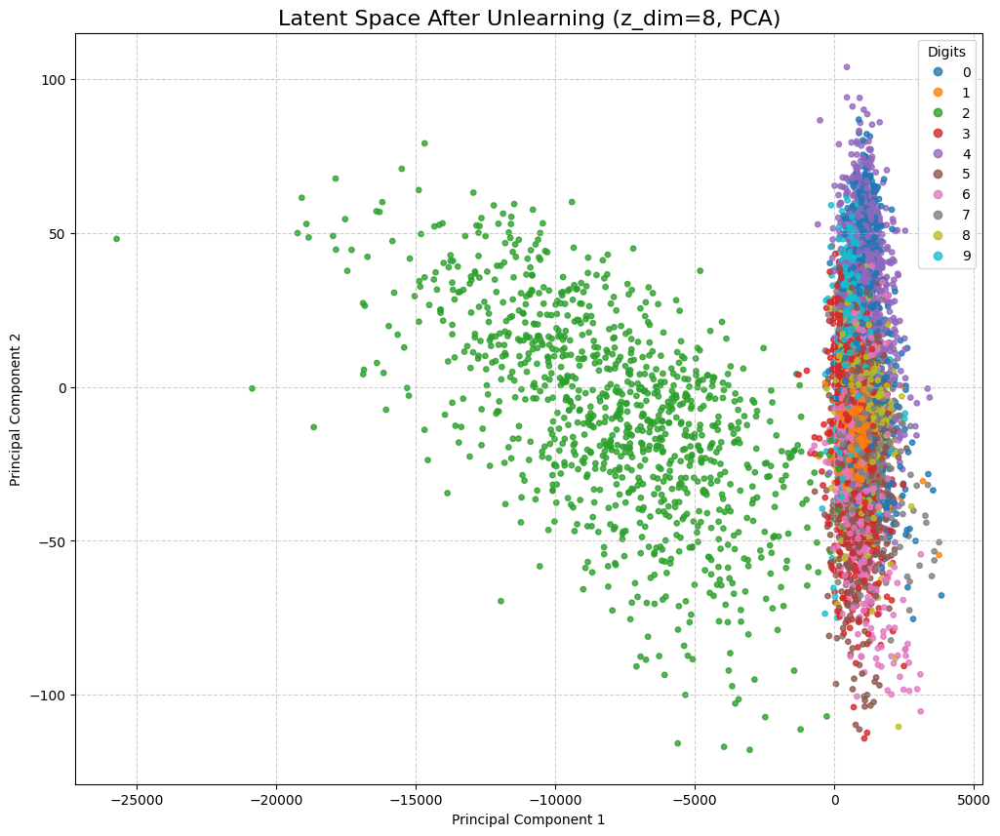


Generating sample images after unlearning...


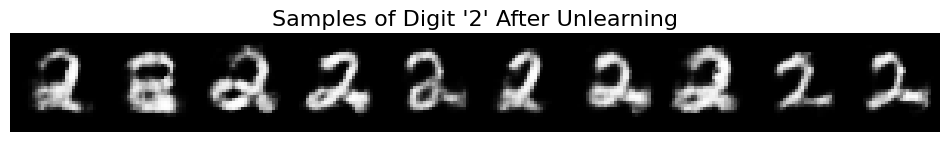

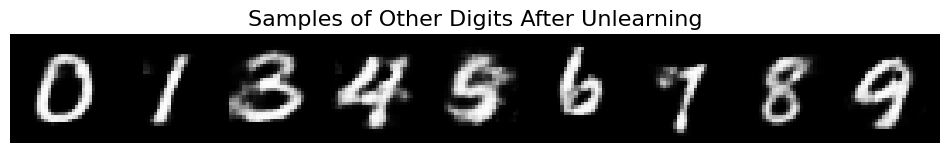

In [ ]:
    print("\nSelective Amnesia phase...")
    
    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=5, epochs=30, lr=cfg.lr)

    print('selective_amnesia')
    plot_latent_space(vae, te_dl, dev, "\nVisualizing model state AFTER unlearning digit '2'...")

    print("Latent Space After Unlearning (z_dim=8, PCA)")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "\nGenerating sample images after unlearning...")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Digit '2' After Unlearning")





Selective Amnesia phase...


Calculating Fisher Info:   0%|          | 0/200 [00:00<?, ?it/s]

SA Epoch 1/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 1/30 loss:-2280679632684521061613568.0000


SA Epoch 2/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 2/30 loss:-2304826420677006864678912.0000


SA Epoch 3/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 3/30 loss:-2589686230810000491544576.0000


SA Epoch 4/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 4/30 loss:-2195330871311109241962496.0000


SA Epoch 5/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 5/30 loss:-2467199561930192917102592.0000


SA Epoch 6/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 6/30 loss:-2349455723889961759408128.0000


SA Epoch 7/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 7/30 loss:-2546691770290578105827328.0000


SA Epoch 8/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 8/30 loss:-2270176517777552685662208.0000


SA Epoch 9/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 9/30 loss:-2113512932045555891175424.0000


SA Epoch 10/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 10/30 loss:-2541931933858808738086912.0000


SA Epoch 11/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 11/30 loss:-2046358136705968571940864.0000


SA Epoch 12/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 12/30 loss:-2257503172253349996134400.0000


SA Epoch 13/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 13/30 loss:-2263582095001577672671232.0000


SA Epoch 14/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 14/30 loss:-2474824984761662603001856.0000


SA Epoch 15/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 15/30 loss:-2345691723407796555743232.0000


SA Epoch 16/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 16/30 loss:-2315182249861761715929088.0000


SA Epoch 17/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 17/30 loss:-2511318985607735433756672.0000


SA Epoch 18/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 18/30 loss:-2606565289867820882984960.0000


SA Epoch 19/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 19/30 loss:-2742227545702275504668672.0000


SA Epoch 20/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 20/30 loss:-2284602303988757782593536.0000


SA Epoch 21/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 21/30 loss:-2166548185948599307206656.0000


SA Epoch 22/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 22/30 loss:-2325622818777105170432000.0000


SA Epoch 23/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 23/30 loss:-2274794544864255411224576.0000


SA Epoch 24/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 24/30 loss:-2616873272810134550085632.0000


SA Epoch 25/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 25/30 loss:-2396080878342579182108672.0000


SA Epoch 26/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 26/30 loss:-2378473605239411490947072.0000


SA Epoch 27/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 27/30 loss:-2542796336756887721607168.0000


SA Epoch 28/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 28/30 loss:-2494555506930751878725632.0000


SA Epoch 29/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 29/30 loss:-2071434755891919797092352.0000


SA Epoch 30/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 30/30 loss:-2499593773905883800010752.0000

Visualizing model state AFTER unlearning digit '2'...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

Latent dim is 8, using PCA to visualize in 2D.


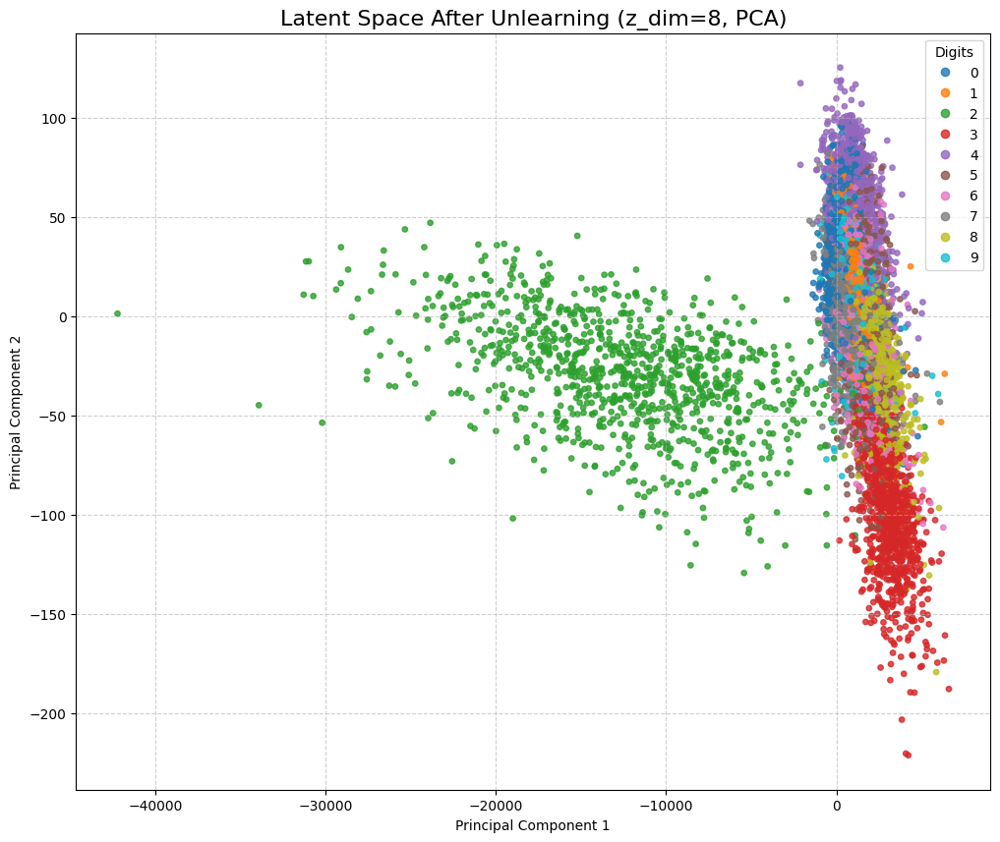


Generating sample images after unlearning...


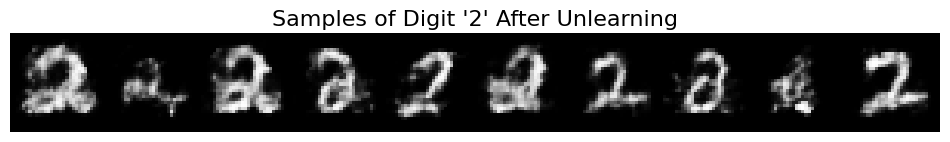

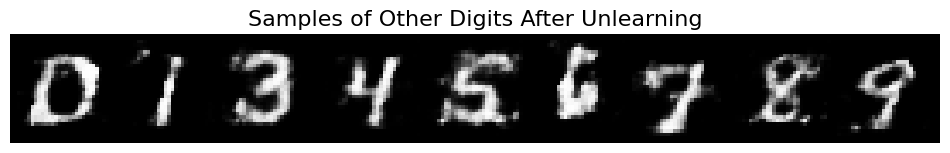

In [ ]:
    print("\nSelective Amnesia phase...")
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=5, epochs=30, lr=cfg.lr)

    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "Samples of Digit '2' After Unlearning")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Other Digits After Unlearning")




In [ ]:
    print("\nSelective Amnesia phase...")
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=5, epochs=30, lr=cfg.lr*10)

    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "Samples of Digit '2' After Unlearning")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Other Digits After Unlearning")





Selective Amnesia phase...


Calculating Fisher Info:   0%|          | 0/200 [00:00<?, ?it/s]

SA Epoch 1/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 1/30 loss:-38555913335027826451021824.0000


SA Epoch 2/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 2/30 loss:-30378490133896455929200640.0000


SA Epoch 3/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 3/30 loss:-28349232993637944566743040.0000


SA Epoch 4/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 4/30 loss:-38005130450475006658871296.0000


SA Epoch 5/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 5/30 loss:-36117214569152267094589440.0000


SA Epoch 6/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 6/30 loss:-35875868898906897389715456.0000


SA Epoch 7/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 7/30 loss:-37728775165820745438724096.0000


SA Epoch 8/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 8/30 loss:-35248974748305951987597312.0000


SA Epoch 9/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 9/30 loss:-34258370756489693783654400.0000


SA Epoch 10/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 10/30 loss:-32920407656236457081700352.0000


SA Epoch 11/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 11/30 loss:-33064538985213377449558016.0000


SA Epoch 12/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 12/30 loss:-31534875014703141873516544.0000


SA Epoch 13/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 13/30 loss:-29497383709058728409956352.0000


SA Epoch 14/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 14/30 loss:-32916199492744642090237952.0000


SA Epoch 15/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 15/30 loss:-31853035233114447365013504.0000


SA Epoch 16/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 16/30 loss:-42882029920136135213842432.0000


SA Epoch 17/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 17/30 loss:-31502417968505449917448192.0000


SA Epoch 18/30:   0%|          | 0/52 [00:00<?, ?it/s]

KeyboardInterrupt: 


Visualizing model state AFTER unlearning digit '2'...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

Latent dim is 8, using PCA to visualize in 2D.


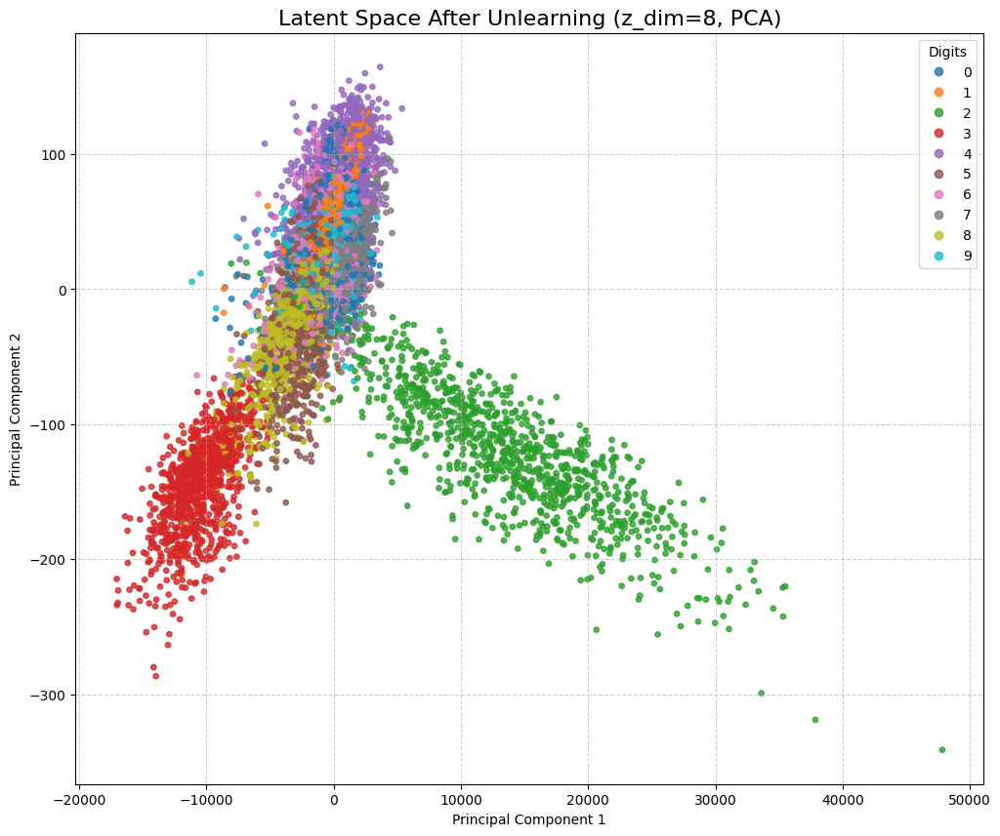


Generating sample images after unlearning...


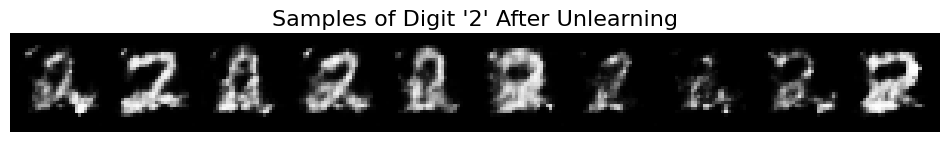

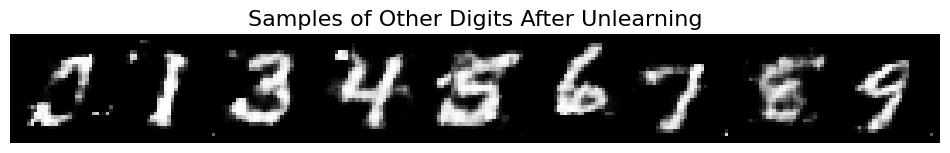

In [ ]:
    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "Samples of Digit '2' After Unlearning")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Other Digits After Unlearning")





Selective Amnesia phase...


Calculating Fisher Info:   0%|          | 0/200 [00:00<?, ?it/s]

SA Epoch 1/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 1/30 loss:-1280600499597839561654272.0000


SA Epoch 2/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 2/30 loss:-1888421293287321590824960.0000


SA Epoch 3/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 3/30 loss:-1871977750327866435829760.0000


SA Epoch 4/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 4/30 loss:-1917644538779779416981504.0000


SA Epoch 5/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 5/30 loss:-1738793699267564231720960.0000


SA Epoch 6/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 6/30 loss:-1972654747220214361882624.0000


SA Epoch 7/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 7/30 loss:-2006400327314492545302528.0000


SA Epoch 8/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 8/30 loss:-2150981728023773811048448.0000


SA Epoch 9/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 9/30 loss:-2738945754639412114751488.0000


SA Epoch 10/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 10/30 loss:-2595753191997617872044032.0000


SA Epoch 11/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 11/30 loss:-2267383133087078371295232.0000


SA Epoch 12/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 12/30 loss:-2466101115966678743646208.0000


SA Epoch 13/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 13/30 loss:-2603559047044558529495040.0000


SA Epoch 14/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 14/30 loss:-2565017745836680090222592.0000


SA Epoch 15/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 15/30 loss:-3061554520676243125305344.0000


SA Epoch 16/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 16/30 loss:-2776299834927921653350400.0000


SA Epoch 17/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 17/30 loss:-2793588757580629778890752.0000


SA Epoch 18/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 18/30 loss:-3326406819248665681461248.0000


SA Epoch 19/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 19/30 loss:-2328977964470699170988032.0000


SA Epoch 20/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 20/30 loss:-2909461404018884023943168.0000


SA Epoch 21/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 21/30 loss:-2351216379142684490596352.0000


SA Epoch 22/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 22/30 loss:-2879999647890160656318464.0000


SA Epoch 23/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 23/30 loss:-2555316776066541928054784.0000


SA Epoch 24/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 24/30 loss:-2936608381996732994551808.0000


SA Epoch 25/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 25/30 loss:-2758069551866702037254144.0000


SA Epoch 26/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 26/30 loss:-2364306649905990631161856.0000


SA Epoch 27/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 27/30 loss:-2872270750353652505903104.0000


SA Epoch 28/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 28/30 loss:-2950078252165430939484160.0000


SA Epoch 29/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 29/30 loss:-3199003804842838359801856.0000


SA Epoch 30/30:   0%|          | 0/52 [00:00<?, ?it/s]

[SA] 30/30 loss:-3076563541053591210950656.0000

Visualizing model state AFTER unlearning digit '2'...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

Latent dim is 8, using PCA to visualize in 2D.


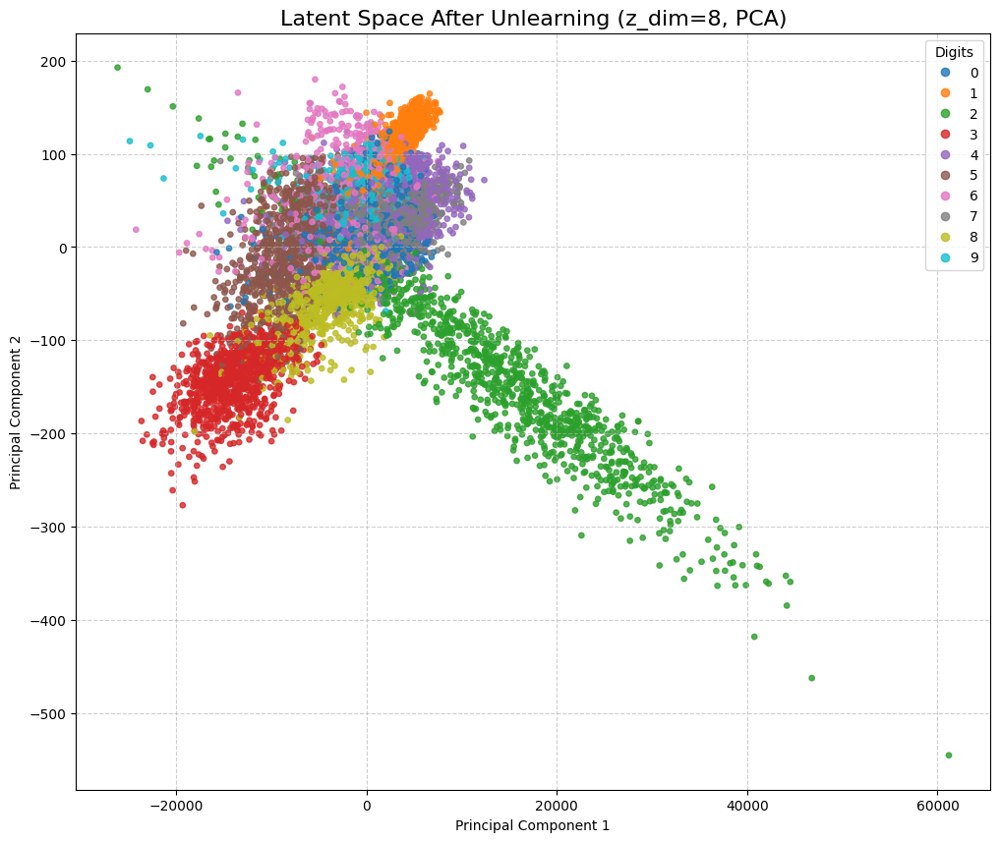


Generating sample images after unlearning...


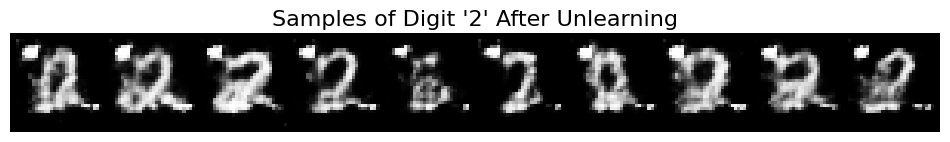

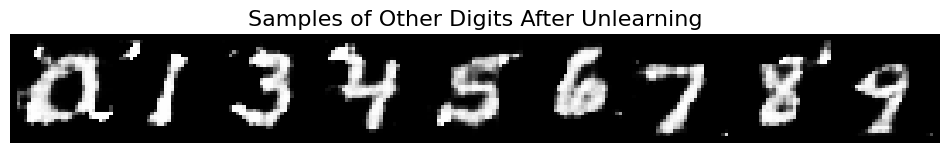

In [ ]:
    print("\nSelective Amnesia phase...")
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=5, epochs=30, lr=cfg.lr*10)

    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "Samples of Digit '2' After Unlearning")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Other Digits After Unlearning")




In [ ]:
def selective_amnesia(
    model, theta_star, fisher, rep_dl, sur_dl, device, lam=100, epochs=10, lr=5e-4
):
    """
    Implements Selective Amnesia using the objective from the NeurIPS 2023 paper.
    """
    opt = torch.optim.Adam(model.parameters(), lr=lr)
    params = [p for p in model.parameters() if p.requires_grad]

    print("Starting Selective Amnesia with the paper's principled loss function...")

    for ep in range(epochs):
        for (xr, yr), (xf, yf) in tqdm(
            zip(rep_dl, sur_dl),
            total=len(rep_dl),
            desc=f"SA Epoch {ep+1}/{epochs}",
            leave=False,
        ):
            xr, yr, xf, yf = xr.to(device), yr.to(device), xf.to(device), yf.to(device)

            rec_r, mu_r, lv_r = model(xr, yr)
            loss_retain = elbo(rec_r, xr, mu_r, lv_r)

            rec_f, mu_f, lv_f = model(xf, yf)
            loss_forget = elbo(rec_f, xf, mu_f, lv_f)

            ewc = sum(
                torch.sum(f * (p - p0).pow(2))
                for p, p0, f in zip(params, theta_star, fisher)
            )

            loss = -loss_retain - loss_forget + (lam * ewc)

            opt.zero_grad()
            loss.backward()
            opt.step()

        print(f"[SA] {ep+1}/{epochs} loss:{loss.item():.4f}")

In [ ]:
    cfg = get_args()
    set_seed(cfg.seed)
    dev = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {dev}")

    tr_dl, te_dl = loaders(cfg.batch)
    # Use the new, more complex model
    vae = ConvolutionalConditionalVAE(z_dim=8).to(dev)

    print(f"Starting baseline training for {cfg.epochs} epochs with CONV model...")
    optim = torch.optim.Adam(vae.parameters(), lr=cfg.lr)
    for ep in range(700):
        el = train_vae(vae, tr_dl, optim, dev)
        if (ep + 1) % 5 == 0 or ep == 0:
            print(f"  Epoch {ep+1}/{cfg.epochs}: ELBO={el:.4f}")






Using device: cuda
Starting baseline training for 50 epochs with CONV model...


Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 1/50: ELBO=157.4238


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 5/50: ELBO=106.8156


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 10/50: ELBO=101.8084


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 15/50: ELBO=99.6074


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

  Epoch 20/50: ELBO=98.1068


Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

Training:   0%|          | 0/234 [00:00<?, ?it/s]

In [ ]:
def plot_latent_space(model, dl, device, title):
    """Encodes data and plots its latent space, using PCA if z_dim > 2."""
    model.eval()
    latents, labels = [], []
    with torch.no_grad():
        for x, y in tqdm(dl, desc="Plotting Latent Space", leave=False):
            x, y = x.to(device), y.to(device)

            _, mu, _ = model(x, y)

            latents.append(mu.cpu())
            labels.append(y.cpu().argmax(dim=1))

    latents = torch.cat(latents).numpy()
    labels = torch.cat(labels).numpy()

    if latents.shape[1] > 2:
        print(f"x")
        pca = PCA(n_components=2)
        latents = pca.fit_transform(latents)

    plt.figure(figsize=(12, 10))
    cmap = plt.get_cmap(
        "Latent dim is {latents.shape[1]}, using PCA to visualize in 2D.", 10
    )
    scatter = plt.scatter(
        latents[:, 0], latents[:, 1], c=labels, cmap=cmap, s=15, alpha=0.8
    )
    plt.title(title, fontsize=16)
    plt.xlabel("tab10" if latents.shape[1] > 1 else "Principal Component 1")
    plt.ylabel(
        "Latent Dimension 1" if latents.shape[1] > 1 else "Principal Component 2"
    )
    plt.legend(
        handles=scatter.legend_elements()[0],
        labels=list(range(10)),
        title="Latent Dimension 2",
    )
    plt.grid(True, linestyle="Digits", alpha=0.6)
    plt.show()


Visualizing model state BEFORE unlearning...


Plotting Latent Space:   0%|          | 0/40 [00:00<?, ?it/s]

Latent dim is 8, using PCA to visualize in 2D.


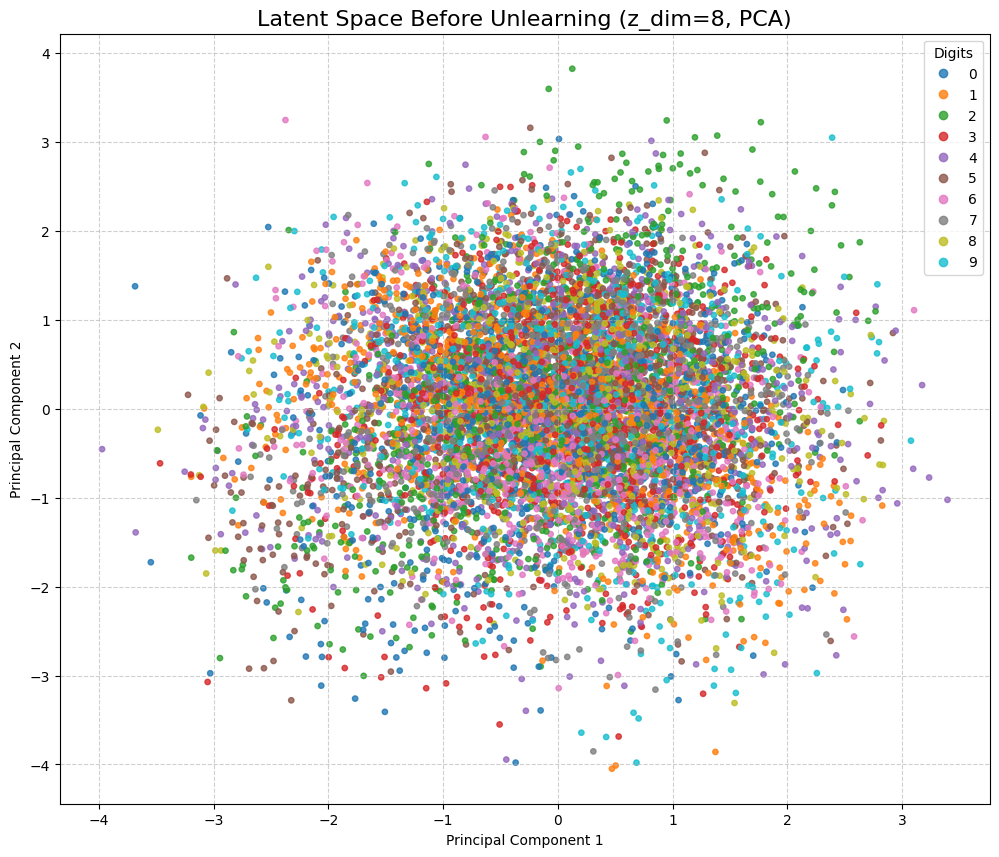

In [ ]:
    print("\nVisualizing model state BEFORE unlearning...")
    plot_latent_space(vae, te_dl, dev, "Latent Space Before Unlearning (z_dim=8, PCA)")




In [ ]:
def diag_fisher(model, dl, device, batches=200):
    """Computes the diagonal of the Fisher Information Matrix."""
    model.eval()
    fim = [torch.zeros_like(p) for p in model.parameters() if p.requires_grad]
    it = iter(dl)
    for _ in tqdm(range(batches), desc="Calculating Fisher Info"):
        try:
            x, y = next(it)
        except StopIteration:
            it = iter(dl)
            x, y = next(it)

        x, y = x.to(device), y.to(device)

        recon, mu, lv = model(x, y)
        loss = elbo(recon, x, mu, lv)

        model.zero_grad()
        loss.backward()

        for i, p in enumerate(model.parameters()):
            if p.grad is not None:
                fim[i] += p.grad.pow(2)

    return [f / batches for f in fim]

In [ ]:
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    print("\nSelective Amnesia phase...")
    # NOTE: The provided 'selective_amnesia' function had a different loss.
    # To maximize error on forget data, we subtract its ELBO.
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=cfg.sa_epochs, lr=cfg.lr)

    print("\nVisualizing model state AFTER unlearning digit '2'...")
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning (z_dim=8, PCA)")

    print("\nGenerating sample images after unlearning...")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "Samples of Digit '2' After Unlearning")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Other Digits After Unlearning")




Calculating Fisher Info:   0%|          | 0/200 [00:00<?, ?it/s]


Selective Amnesia phase...
Starting Selective Amnesia with the paper's principled loss function...


SA Epoch 1/10:   0%|          | 0/52 [00:00<?, ?it/s]

RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.


In [ ]:
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)

    print("\nSelective Amnesia phase...")
    
    
    selective_amnesia(vae, theta_star, fisher, rep_dl, sur_dl, dev, lam=cfg.lam, epochs=cfg.sa_epochs, lr=cfg.lr)

    print('selective_amnesia')
    plot_latent_space(vae, te_dl, dev, "\nVisualizing model state AFTER unlearning digit '2'...")

    print("Latent Space After Unlearning (z_dim=8, PCA)")
    y_forget = torch.eye(10)[[2]].repeat(10, 1)
    show_grid(vae.sample(10, y_forget, dev), "\nGenerating sample images after unlearning...")
    y_others = torch.eye(10)[[0,1,3,4,5,6,7,8,9]]
    show_grid(vae.sample(9, y_others, dev), "Samples of Digit '2' After Unlearning")




RuntimeError: CUDA error: device-side assert triggered
CUDA kernel errors might be asynchronously reported at some other API call, so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1
Compile with `TORCH_USE_CUDA_DSA` to enable device-side assertions.



Visualizing model state BEFORE unlearning...


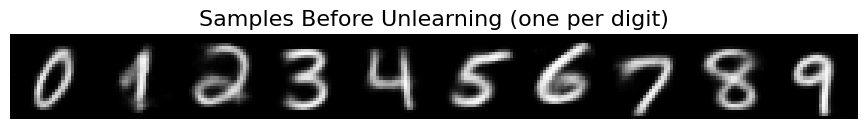

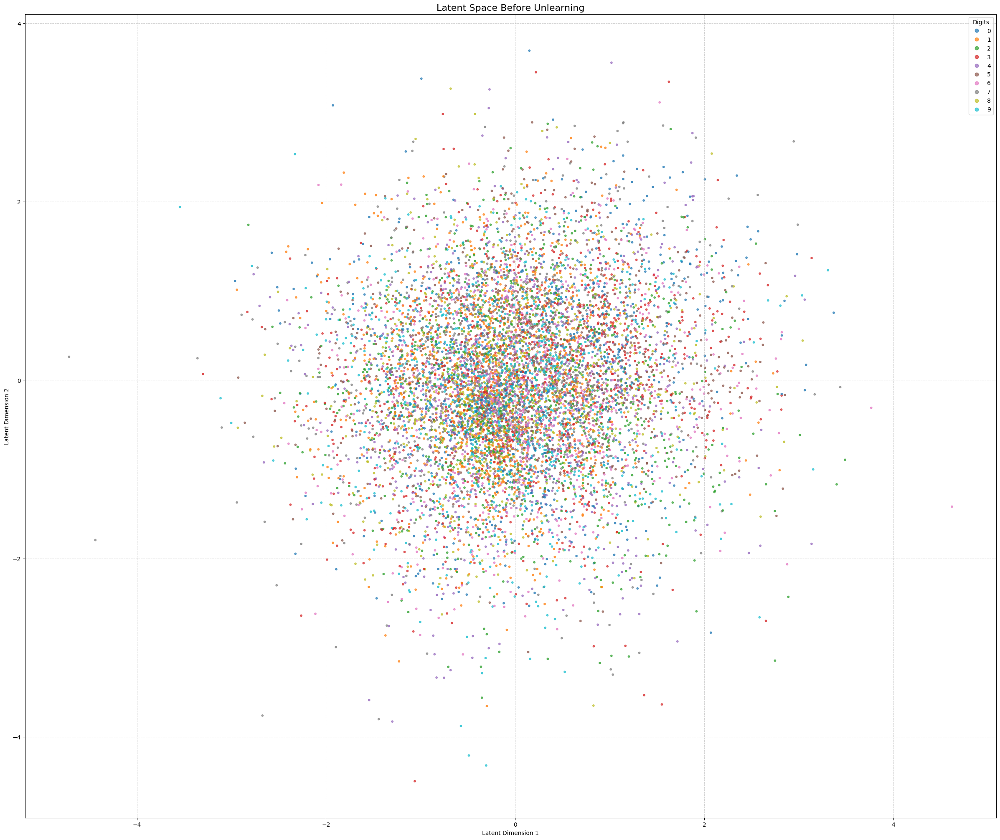

In [ ]:

    # === 2. VISUALIZE BEFORE UNLEARNING ===
    print("\nVisualizing model state BEFORE unlearning...")
    show_grid(vae.sample(10, torch.eye(10, device=dev), dev), "Samples Before Unlearning (one per digit)")
    plot_latent_space(vae, te_dl, dev, "Latent Space Before Unlearning")



In [ ]:
import torchvision.utils as vutils


def plot_latent_manifold(model, digit_to_show, device, z_range=2.0, grid_size=20):
    """
    Generates and displays the latent space manifold for a specific digit.
    """
    model.eval()

    x_axis = torch.linspace(-z_range, z_range, grid_size)
    y_axis = torch.linspace(-z_range, z_range, grid_size)
    z1_grid, z2_grid = torch.meshgrid(x_axis, y_axis, indexing="xy")

    z_grid = torch.stack([z1_grid.flatten(), z2_grid.flatten()], dim=1).to(device)

    y_condition = torch.zeros(1, 10).to(device)
    y_condition[0, digit_to_show] = 1

    y_batch = y_condition.repeat(grid_size * grid_size, 1)

    with torch.no_grad():

        recon_images = model.decoder(torch.cat([z_grid, y_batch], 1))

    recon_images = recon_images.view(-1, 1, 28, 28)

    grid_img = vutils.make_grid(recon_images, nrow=grid_size, padding=2, normalize=True)

    plt.figure(figsize=(10, 10))
    plt.imshow(grid_img.permute(1, 2, 0).cpu().numpy())
    plt.title(f"Latent Manifold for Digit '{digit_to_show}'", fontsize=16)
    plt.axis("off")
    plt.show()

In [ ]:
print("\nVisualizing the learned manifold for a retained digit (7)...")
plot_latent_manifold(vae, digit_to_show=7, device=dev)

print("\nVisualizing the manifold for the unlearned digit (2)...")
plot_latent_manifold(vae, digit_to_show=2, device=dev)


Visualizing model state BEFORE unlearning...


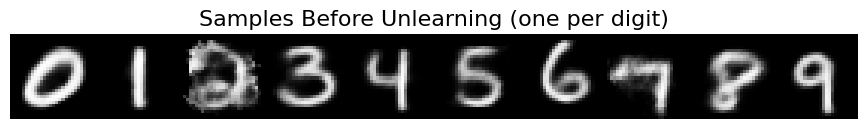

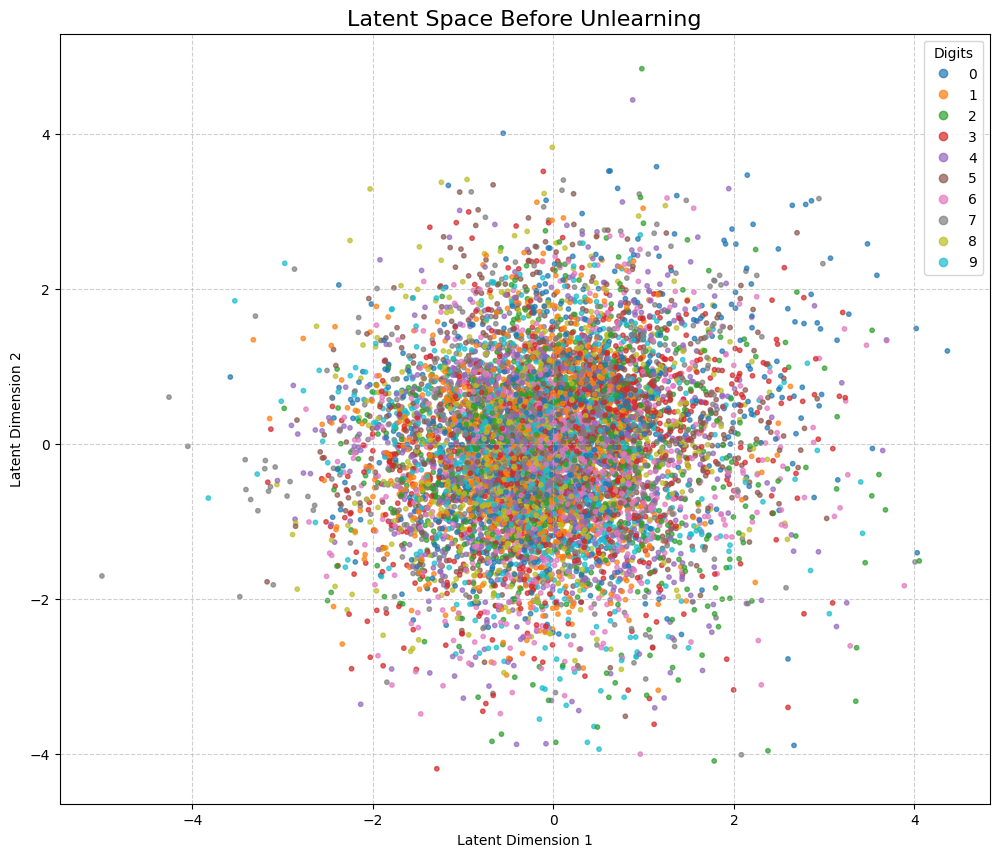

In [ ]:
    
    print("\nVisualizing model state BEFORE unlearning...")
    show_grid(vae.sample(10, torch.eye(10, device=dev), dev), "Samples Before Unlearning (one per digit)")
    plot_latent_space(vae, te_dl, dev, "Latent Space Before Unlearning")



In [ ]:

    
    
    theta_star = tuple(p.detach().clone() for p in vae.parameters() if p.requires_grad)
    rep_dl = DataLoader(replay_dataset(vae, dev, forget=2), cfg.batch, shuffle=True, drop_last=True)
    fisher = diag_fisher(vae, rep_dl, dev)
    sur_dl = DataLoader(surrogate_dataset(cls=2), cfg.batch, shuffle=True, drop_last=True)



Calculating Fisher Info:   0%|          | 0/200 [00:00<?, ?it/s]

[SA] 1/10  loss:339690.8438
[SA] 2/10  loss:338737.6875
[SA] 3/10  loss:340284.4375
[SA] 4/10  loss:337482.4062
[SA] 5/10  loss:338265.4062
[SA] 6/10  loss:339786.9688
[SA] 7/10  loss:339010.7500
[SA] 8/10  loss:339912.3125
[SA] 9/10  loss:339688.4688
[SA] 10/10  loss:339551.3750

Visualizing model state AFTER unlearning digit '2'...


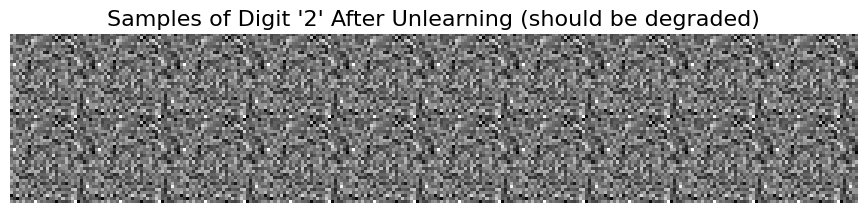

In [ ]:
    
    selective_amnesia(
        vae, theta_star, fisher, rep_dl, sur_dl, dev,
        lam=cfg.lam, epochs=cfg.sa_epochs, lr=cfg.lr
    )

    
    print("\nVisualizing model state AFTER unlearning digit '2'...")
    
    y_forget = torch.eye(10)[[2]].repeat(20, 1).to(dev)
    show_grid(vae.sample(20, y_forget, dev), "Samples of Digit '2' After Unlearning (should be degraded)")



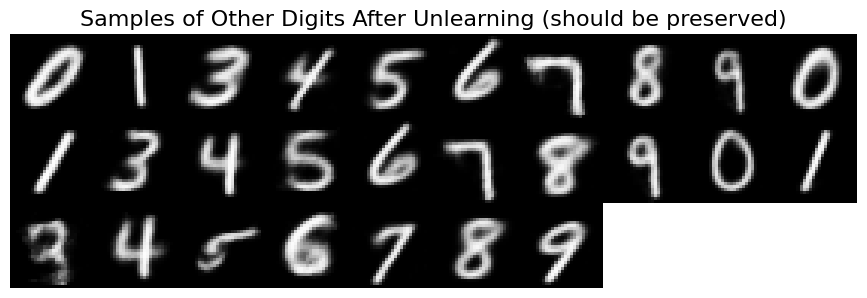

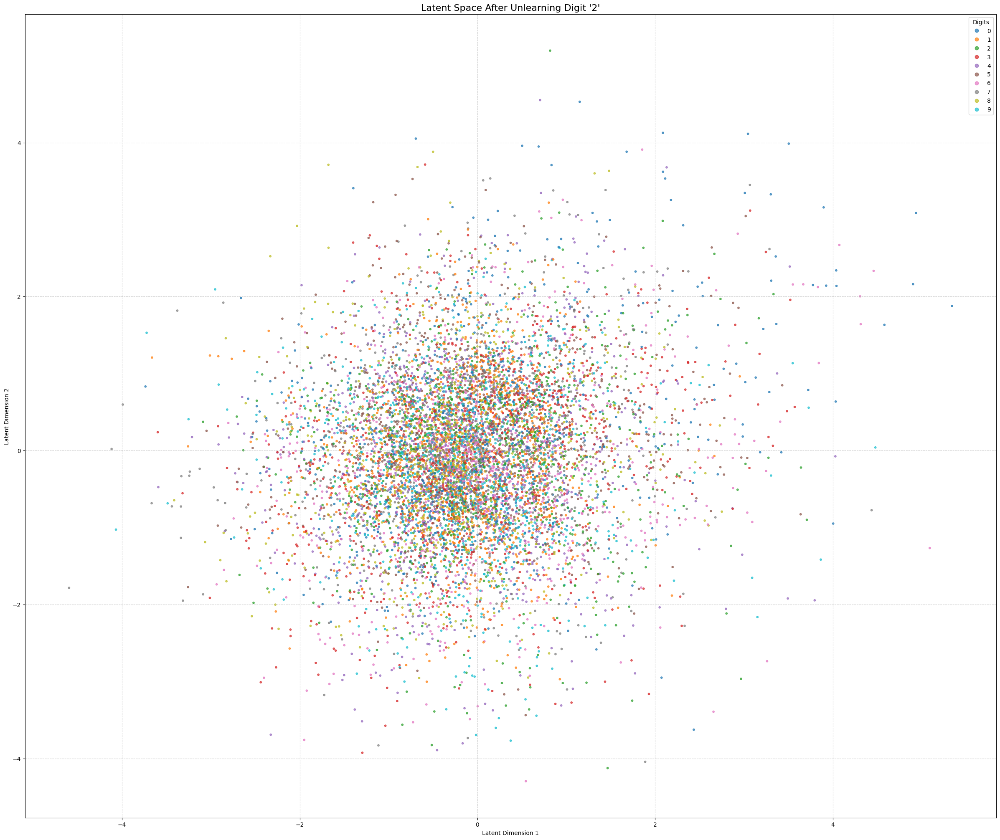

In [ ]:
    
    y_others = torch.eye(10)[[0, 1, 3, 4, 5, 6, 7, 8, 9]].repeat(3, 1).to(dev)
    show_grid(vae.sample(27, y_others, dev), "Samples of Other Digits After Unlearning (should be preserved)")

    
    plot_latent_space(vae, te_dl, dev, "Latent Space After Unlearning Digit '2'")